# Prosit 2: Hidden Patterns in Student Journeys
## Unsupervised Learning & Clustering Analysis

**Objective**: Discover meaningful structure in the data without predefined labels. Identify groups of students with similar academic pathways and detect bottlenecks and outliers.

**Key Questions**:
- Are there groups of students with similar academic pathways?
- Can we identify bottlenecks and outliers?
- What hidden patterns exist in student success journeys?

## 1. Setup & Data Loading

In [2]:
pip -q install pandas numpy plotly scikit-learn scipy umap-learn joblib

In [3]:
# Import libraries
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Clustering algorithms
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
from sklearn.mixture import GaussianMixture

# Dimensionality reduction
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
try:
    import umap
    UMAP_AVAILABLE = True
except ImportError:
    UMAP_AVAILABLE = False
    print("⚠️  UMAP not installed. Install with: pip install umap-learn")

# Preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer

# Evaluation metrics
from sklearn.metrics import silhouette_score, davies_bouldin_score, calinski_harabasz_score

# Hierarchical clustering visualization
from scipy.cluster.hierarchy import dendrogram, linkage

# Utilities
import warnings
warnings.filterwarnings('ignore')

print("✅ Libraries loaded successfully!")
print(f"UMAP available: {UMAP_AVAILABLE}")

✅ Libraries loaded successfully!
UMAP available: True


In [4]:
# Load the ENCODED dataset from Prosit 1
df = pd.read_csv('./data/merged_cleaned_encoded.csv')

print(f"Dataset shape: {df.shape}")
print(f"Rows: {df.shape[0]:,} | Columns: {df.shape[1]}")
print(f"\n✅ Using encoded dataset with categorical variables already converted to numeric!")
df.head()

Dataset shape: (538147, 56)
Rows: 538,147 | Columns: 56

✅ Using encoded dataset with categorical variables already converted to numeric!


,Applicant,Application,Created date,Submitted date,Offer type,Offer course name,StudentRef,Latest Education Level,Education - Block 1: Level of education,Education - Block 2: Level of education,...,GPA_y,CGPA_y,Subject Credit,Calculate toward Graduation Criteria?,Course offering plan name,Student Type,Student Status,Nationality,Admission Year,Program
0,557,470,15/01/2018 5:20,02/06/2018 18:15,3,2,Sd25fcbb18e84f890,4,4,2,...,NaN,NaN,NaN,NaN,2,NaN,5,0,7,9
1,566,473,15/01/2018 19:28,14/08/2018 12:33,3,5,Sfd5f545f824e3b45,4,4,2,...,NaN,NaN,NaN,NaN,2,NaN,5,0,7,9
2,569,479,15/01/2018 21:10,14/08/2018 21:05,3,4,Se4a2f9bcf28873f3,4,4,2,...,NaN,NaN,NaN,NaN,2,NaN,5,24,7,9
3,572,482,15/01/2018 21:19,16/08/2018 21:04,3,1,S2c5748435b37f518,4,4,2,...,NaN,NaN,NaN,NaN,2,NaN,5,0,7,9
4,575,485,15/01/2018 23:47,21/01/2018 2:16,3,6,Sa3d7b10c3d22ffe0,2,4,2,...,NaN,NaN,NaN,NaN,2,NaN,5,17,7,9


In [5]:
# Verify data types
print("Data type distribution:")
print(df.dtypes.value_counts())
print(f"\nNumeric columns: {df.select_dtypes(include=[np.number]).shape[1]}")
print(f"Object columns: {df.select_dtypes(include=['object']).shape[1]}")

Data type distribution:
int64      30
object     18
float64     8
Name: count, dtype: int64

Numeric columns: 38
Object columns: 18


## 2. Feature Selection & Preparation

In [6]:
# Select numeric features for clustering
numeric_cols = df.select_dtypes(include=[np.number]).columns.tolist()

print(f"Total numeric columns: {len(numeric_cols)}")
print(f"\nFirst 20 numeric columns:")
for i, col in enumerate(numeric_cols[:20], 1):
    print(f"{i:2d}. {col}")

Total numeric columns: 38

First 20 numeric columns:
 1. Applicant
 2. Application
 3. Offer type
 4. Offer course name
 5. Latest Education Level
 6. Education - Block 1: Level of education
 7. Education - Block 2: Level of education
 8. Extra question: Have any of your family members gained admission to Ashesi University?
 9. Extra question: Is he/she alive?
10. Extra question: Is he/she alive?.1
11. Extra question: Is he/she alive?.2
12. Extra question: Level of education.2
13. Extra question: Is he/she alive?.3
14. Extra question: Level of education.3
15. Extra question: Type of Exam
16. Extra question: Do you Need Financial Aid?
17. Yeargroup
18. Semester/Year_x
19. Academic Year_x
20. Application Category


In [7]:
# Analyze missing values in numeric columns
missing_pct = (df[numeric_cols].isnull().sum() / len(df) * 100).sort_values(ascending=False)

print("Missing value percentages (top 20):")
print(missing_pct.head(20))

# Select columns with less than 50% missing values
good_cols = missing_pct[missing_pct < 50].index.tolist()
print(f"\nColumns with <50% missing: {len(good_cols)}")

Missing value percentages (top 20):
Mark                                                                                      2.560081
GPA_y                                                                                     1.941663
CGPA_y                                                                                    1.941663
Grade point                                                                               1.941663
Subject Credit                                                                            1.941663
CGPA_x                                                                                    1.914347
Yeargroup                                                                                 1.914347
GPA_x                                                                                     1.914347
Education - Block 1: Level of education                                                   0.000000
Latest Education Level                                                   

In [8]:
# Remove identifier columns (numeric IDs that passed the numeric filter)
# Note: Non-numeric identifiers like 'StudentRef' (object type) are already excluded
# This step removes numeric IDs like 'Applicant' and 'Application' which are arbitrary
# sequential numbers with no semantic meaning for clustering patterns
id_patterns = ['Ref', 'ID', 'id', 'Applicant', 'Application', 'Student']
feature_cols = [col for col in good_cols if not any(pattern in col for pattern in id_patterns)]

print(f"Features after removing IDs: {len(feature_cols)}")
print(f"\nSelected features for clustering:")
for i, col in enumerate(feature_cols[:30], 1):
    print(f"{i:2d}. {col}")

if len(feature_cols) > 30:
    print(f"... and {len(feature_cols) - 30} more")

Features after removing IDs: 32

Selected features for clustering:
 1. Mark
 2. GPA_y
 3. CGPA_y
 4. Grade point
 5. Subject Credit
 6. CGPA_x
 7. Yeargroup
 8. GPA_x
 9. Education - Block 1: Level of education
10. Latest Education Level
11. Offer course name
12. Offer type
13. Extra question: Level of education.3
14. Extra question: Is he/she alive?.3
15. Extra question: Level of education.2
16. Education - Block 2: Level of education
17. Extra question: Is he/she alive?.2
18. Extra question: Have any of your family members gained admission to Ashesi University?
19. Extra question: Is he/she alive?
20. Extra question: Is he/she alive?.1
21. Academic Year_x
22. Semester/Year_x
23. Extra question: Type of Exam
24. Gender
25. Semester/Year_y
26. Grade system
27. Grade
28. Academic Year_y
29. Course offering plan name
30. Nationality
... and 2 more


In [9]:
# Prepare clustering dataset
X = df[feature_cols].copy()

print(f"Initial clustering data shape: {X.shape}")
print(f"Missing values: {X.isnull().sum().sum():,}")

# Impute missing values with median
imputer = SimpleImputer(strategy='median')
X_imputed = pd.DataFrame(
    imputer.fit_transform(X),
    columns=X.columns,
    index=X.index
)

# Remove any infinite values
X_imputed = X_imputed.replace([np.inf, -np.inf], np.nan)
X_imputed = X_imputed.fillna(X_imputed.median())

print(f"\nAfter imputation:")
print(f"  Shape: {X_imputed.shape}")
print(f"  Missing values: {X_imputed.isnull().sum().sum()}")
print(f"  ✅ Data ready for clustering!")

Initial clustering data shape: (538147, 32)
Missing values: 86,479

After imputation:
  Shape: (538147, 32)
  Missing values: 0
  ✅ Data ready for clustering!


## 3. Data Preprocessing & Scaling

In [10]:
# Standardize features (critical for distance-based clustering!)
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_imputed)

print(f"Scaled data shape: {X_scaled.shape}")
print(f"Mean: {X_scaled.mean():.6f}")
print(f"Std: {X_scaled.std():.6f}")
print(f"Min: {X_scaled.min():.2f}")
print(f"Max: {X_scaled.max():.2f}")

Scaled data shape: (538147, 32)
Mean: 0.000000
Std: 1.000000
Min: -21.29
Max: 8.73


## 4. Dimensionality Reduction with PCA

In [11]:
# Apply PCA
pca = PCA(n_components=2, random_state=42)
X_pca = pca.fit_transform(X_scaled)

# Explained variance
explained_var = pca.explained_variance_ratio_
cumulative_var = np.cumsum(explained_var)

# Find components for 95% variance
n_components_95 = np.argmax(cumulative_var >= 0.95) + 1

print(f"Total components: {len(explained_var)}")
print(f"Components for 95% variance: {n_components_95}")
print(f"\nTop 10 components variance:")
for i, var in enumerate(explained_var[:10], 1):
    print(f"  PC{i}: {var:.4f} ({cumulative_var[i-1]:.4f} cumulative)")

Total components: 2
Components for 95% variance: 1

Top 10 components variance:
  PC1: 0.1907 (0.1907 cumulative)
  PC2: 0.1428 (0.3335 cumulative)


In [12]:
# Visualize explained variance
fig = make_subplots(
    rows=1, cols=2,
    subplot_titles=('Explained Variance by Component', 'Cumulative Explained Variance')
)

# Individual variance
n_show = min(30, len(explained_var))
fig.add_trace(
    go.Bar(x=list(range(1, n_show+1)),
           y=explained_var[:n_show],
           marker_color='steelblue',
           name='Individual'),
    row=1, col=1
)

# Cumulative variance
fig.add_trace(
    go.Scatter(x=list(range(1, n_show+1)),
               y=cumulative_var[:n_show],
               mode='lines+markers',
               marker_color='coral',
               line=dict(width=2),
               name='Cumulative'),
    row=1, col=2
)

# Add 95% threshold line
fig.add_hline(y=0.95, line_dash="dash", line_color="red",
              annotation_text="95% threshold", row=1, col=2)

fig.update_xaxes(title_text="Principal Component", row=1, col=1)
fig.update_xaxes(title_text="Number of Components", row=1, col=2)
fig.update_yaxes(title_text="Explained Variance Ratio", row=1, col=1)
fig.update_yaxes(title_text="Cumulative Variance", row=1, col=2)

fig.update_layout(title_text='PCA Analysis', showlegend=False, height=400)
fig.show()

In [13]:
# Use reduced dimensions for clustering
pca_reduced = PCA(n_components=n_components_95)
X_pca_reduced = pca_reduced.fit_transform(X_scaled)

print(f"Original dimensions: {X_scaled.shape[1]}")
print(f"Reduced dimensions: {X_pca_reduced.shape[1]}")
print(f"Variance retained: {cumulative_var[n_components_95-1]:.4f}")
print(f"Dimensionality reduction: {(1 - X_pca_reduced.shape[1]/X_scaled.shape[1])*100:.1f}%")

Original dimensions: 32
Reduced dimensions: 1
Variance retained: 0.1907
Dimensionality reduction: 96.9%


## 4. Multiple embeddings

### 4.1 PCA

In [11]:
from sklearn.decomposition import PCA
pca = PCA(n_components=10)
X_pca = pca.fit_transform(X_scaled)

In [17]:
# Explained variance ratio (fraction of variance per component)
explained_var = pca.explained_variance_ratio_
cumulative_var = np.cumsum(explained_var)

# Print variance percentages for each component
print("=== PCA Variance Percentages ===")
for i, var in enumerate(explained_var, 1):
    print(f"PC{i}: {var*100:.2f}% (cumulative: {cumulative_var[i-1]*100:.2f}%)")

print(f"\nTotal components: {len(explained_var)}")
print(f"Total variance explained: {cumulative_var[-1]*100:.2f}%")

=== PCA Variance Percentages ===
PC1: 19.07% (cumulative: 19.07%)
PC2: 14.28% (cumulative: 33.35%)
PC3: 8.50% (cumulative: 41.85%)
PC4: 7.68% (cumulative: 49.53%)
PC5: 5.27% (cumulative: 54.80%)
PC6: 4.88% (cumulative: 59.68%)
PC7: 4.44% (cumulative: 64.12%)
PC8: 3.91% (cumulative: 68.03%)
PC9: 3.31% (cumulative: 71.34%)
PC10: 3.27% (cumulative: 74.61%)

Total components: 10
Total variance explained: 74.61%


### 4.2 t-SNE

In [ ]:
from sklearn.manifold import TSNE
tsne = TSNE(n_components=2, random_state=42, perplexity=30)
X_tsne = tsne.fit_transform(X_scaled)

### 4.3 UMAP

In [ ]:
import umap
reducer = umap.UMAP(n_components=2, random_state=42, n_neighbors=15, min_dist=0.1)
X_umap = reducer.fit_transform(X_scaled)

### 4.5 Selection

In [18]:
# --- Store embeddings in a dictionary ---
embeddings = {
    "PCA": X_pca,
    # "TSNE": X_tsne,
    # "UMAP": X_umap
}

# --- Example: toggle between embeddings ---
method = "PCA"   # choose "PCA", "TSNE", or "UMAP"
X_selected = embeddings[method]

print(f"Using {method} embedding with shape {X_selected.shape}")

Using PCA embedding with shape (538147, 10)


### 4.6 Create Sample for Computationally Expensive Methods

In [29]:
# Reusable Sampling Function
def create_sample(data, sample_fraction, random_seed=42):
    """
    Create a random sample from the data.

    Parameters:
    -----------
    data : array-like
        The data to sample from (e.g., X_pca_reduced)
    sample_fraction : float
        Fraction of data to sample (e.g., 0.10 for 10%)
    random_seed : int, default=42
        Random seed for reproducibility

    Returns:
    --------
    tuple : (sample_size, sample_indices, X_sample)
        - sample_size: Number of samples
        - sample_indices: Indices of sampled points
        - X_sample: The sampled data
    """
    sample_size = int(len(data) * sample_fraction)
    np.random.seed(random_seed)
    sample_indices = np.random.choice(len(data), size=sample_size, replace=False)
    X_sample = data[sample_indices]

    return sample_size, sample_indices, X_sample

print("✅ Reusable sampling function created!")
print("\nUsage: sample_size, sample_indices, X_sample = create_sample(X_pca_reduced, 0.10)")

✅ Reusable sampling function created!

Usage: sample_size, sample_indices, X_sample = create_sample(X_pca_reduced, 0.10)


In [30]:
# Assume you already have:
# embeddings = {"PCA": X_pca, "TSNE": X_tsne, "UMAP": X_umap}
method = "PCA"  # or "TSNE", "UMAP"
X_selected = embeddings[method]

# Configure sampling percentages for each method
SAMPLING_CONFIG = {
    'hierarchical': 0.05,  # 5% sample for hierarchical clustering
    'dbscan': 0.05,        # 5% sample for DBSCAN (can be slow)
    'gmm': 0.10,           # 10% sample for GMM
    'tsne_umap': 0.10,     # 10% sample for t-SNE/UMAP visualization
    'dendrogram': 0.002    # 0.2% (1000 samples) for dendrogram visualization
}

print("📊 Dataset Sampling for Performance Optimization")
print("=" * 60)
print(f"Full dataset size: {len(X_selected):,} samples")
print(f"\nSampling percentages:")
for method_name, fraction in SAMPLING_CONFIG.items():
    size = int(len(X_selected) * fraction)
    print(f"  • {method_name.upper():15s}: {fraction*100:5.1f}% ({size:,} samples)")

# Create samples for each method using the reusable function
print(f"\n🔄 Creating samples...")

hierarchical_size, hierarchical_indices, X_hierarchical_sample = create_sample(
    X_selected, SAMPLING_CONFIG['hierarchical']
)

dbscan_size, dbscan_indices, X_dbscan_sample = create_sample(
    X_selected, SAMPLING_CONFIG['dbscan']
)

gmm_size, gmm_indices, X_gmm_sample = create_sample(
    X_selected, SAMPLING_CONFIG['gmm']
)

tsne_umap_size, tsne_umap_indices, X_tsne_umap_sample = create_sample(
    X_selected, SAMPLING_CONFIG['tsne_umap']
)

dendrogram_size, dendrogram_indices, X_dendrogram_sample = create_sample(
    X_selected, SAMPLING_CONFIG['dendrogram']
)

print(f"\n✅ All samples created successfully!")
print(f"\nWill use:")
print(f"   • Full dataset for: K-Means (fast)")
print(f"   • {SAMPLING_CONFIG['hierarchical']*100:.0f}% sample for: Hierarchical clustering")
print(f"   • {SAMPLING_CONFIG['dbscan']*100:.0f}% sample for: DBSCAN")
print(f"   • {SAMPLING_CONFIG['gmm']*100:.0f}% sample for: GMM")
print(f"   • {SAMPLING_CONFIG['tsne_umap']*100:.0f}% sample for: t-SNE, UMAP")
print(f"   • {SAMPLING_CONFIG['dendrogram']*100:.1f}% sample for: Dendrogram visualization")


📊 Dataset Sampling for Performance Optimization
Full dataset size: 538,147 samples

Sampling percentages:
  • HIERARCHICAL   :   5.0% (26,907 samples)
  • DBSCAN         :   5.0% (26,907 samples)
  • GMM            :  10.0% (53,814 samples)
  • TSNE_UMAP      :  10.0% (53,814 samples)
  • DENDROGRAM     :   0.2% (1,076 samples)

🔄 Creating samples...

✅ All samples created successfully!

Will use:
   • Full dataset for: K-Means (fast)
   • 5% sample for: Hierarchical clustering
   • 5% sample for: DBSCAN
   • 10% sample for: GMM
   • 10% sample for: t-SNE, UMAP
   • 0.2% sample for: Dendrogram visualization


### 4.7 Visualisation

In [19]:
import plotly.express as px
import pandas as pd

# Assume you already have this dictionary of embeddings:
# embeddings = {"PCA": X_pca, "TSNE": X_tsne, "UMAP": X_umap}

def visualize_embedding(name, X, labels=None):
    """
    Visualize a 2D embedding with Plotly.
    Parameters:
        name   : str, name of the embedding ("PCA", "TSNE", "UMAP")
        X      : array-like, shape (n_samples, n_components)
        labels : optional cluster labels (array-like)
    """
    df = pd.DataFrame({
        "x": X[:, 0],
        "y": X[:, 1],
        "Cluster": labels if labels is not None else ["All"] * len(X)
    })

    fig = px.scatter(
        df, x="x", y="y",
        color="Cluster",
        title=f"{name} Embedding Visualization",
        opacity=0.6,
        color_discrete_sequence=px.colors.qualitative.Vivid
    )
    fig.update_traces(marker=dict(size=5, line=dict(width=0.5, color="white")))
    fig.update_layout(height=600, template="plotly_white")
    fig.show()

# --- Example usage ---
# Visualize PCA embedding (no labels yet, just raw points)
visualize_embedding("PCA", embeddings["PCA"][:, :2])

# # Visualize t-SNE embedding
# visualize_embedding("t-SNE", embeddings["TSNE"])

# # Visualize UMAP embedding
# visualize_embedding("UMAP", embeddings["UMAP"])


## 5. K-Means Clustering

In [20]:
# Multiple Fast Methods for Optimal k Selection
print("Running K-Means with multiple evaluation metrics...\n")

X_pca_reduced = X_pca[:, :10]   # <-- updated to use new PCA
inertias = []  # Within-Cluster Sum of Squares (WCSS)
calinski_scores = []  # Calinski-Harabasz Index (Variance Ratio Criterion)
K_range = range(2, 11)

for k in K_range:
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
    labels = kmeans.fit_predict(X_pca_reduced)

    # WCSS (Inertia)
    wcss = kmeans.inertia_
    inertias.append(wcss)

    # Calinski-Harabasz Score (fast!)
    ch_score = calinski_harabasz_score(X_pca_reduced, labels)
    calinski_scores.append(ch_score)

    print(f"  k={k}: WCSS={wcss:.2f}, Calinski-Harabasz={ch_score:.2f}")

print("\n✅ Evaluation complete!")

# Method 1: Elbow detection using rate of change
inertia_diffs = np.diff(inertias)
inertia_diffs_pct = (inertia_diffs / inertias[:-1]) * 100

elbow_k = None
for idx in range(len(inertia_diffs_pct) - 1):
    if abs(inertia_diffs_pct[idx+1]) < abs(inertia_diffs_pct[idx]) * 0.5:
        elbow_k = K_range[idx+1]
        break

if elbow_k is None:
    elbow_k = K_range[np.argmin(np.abs(inertia_diffs_pct)) + 1]

# Method 2: Calinski-Harabasz (higher is better)
ch_optimal_k = K_range[np.argmax(calinski_scores)]

# Method 3: Davies-Bouldin Score (fast, lower is better)
print("\nCalculating Davies-Bouldin scores...")
davies_bouldin_scores = []
for k in K_range:
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
    labels = kmeans.fit_predict(X_pca_reduced)
    db_score = davies_bouldin_score(X_pca_reduced, labels)
    davies_bouldin_scores.append(db_score)
    print(f"  k={k}: Davies-Bouldin={db_score:.3f}")

db_optimal_k = K_range[np.argmin(davies_bouldin_scores)]

print("\n" + "="*70)
print("OPTIMAL K RECOMMENDATIONS")
print("="*70)
print(f"Method 1 - Elbow (WCSS rate of change):     k = {elbow_k}")
print(f"Method 2 - Calinski-Harabasz (max):         k = {ch_optimal_k}")
print(f"Method 3 - Davies-Bouldin (min):            k = {db_optimal_k}")

# Consensus recommendation
k_votes = [elbow_k, ch_optimal_k, db_optimal_k]
from collections import Counter
k_counts = Counter(k_votes)
consensus_k = k_counts.most_common(1)[0][0]

print(f"\n🎯 CONSENSUS RECOMMENDATION: k = {consensus_k}")
print(f"   (Agreed by {k_counts[consensus_k]}/3 methods)")
print("="*70)

# Create comprehensive visualization
fig = make_subplots(
    rows=2, cols=2,
    subplot_titles=(
        'Elbow Method (WCSS)',
        'Calinski-Harabasz Score (Higher=Better)',
        'WCSS Rate of Decrease (%)',
        'Davies-Bouldin Score (Lower=Better)'
    ),
    vertical_spacing=0.12,
    horizontal_spacing=0.1
)

# Plot 1: WCSS Elbow curve
fig.add_trace(
    go.Scatter(
        x=list(K_range), y=inertias,
        mode='lines+markers',
        marker=dict(size=10, color='steelblue'),
        line=dict(width=3, color='steelblue'),
        name='WCSS',
        hovertemplate='k=%{x}<br>WCSS=%{y:.2f}<extra></extra>'
    ), row=1, col=1
)
# Mark elbow point
elbow_idx = list(K_range).index(elbow_k)
fig.add_trace(
    go.Scatter(
        x=[elbow_k], y=[inertias[elbow_idx]],
        mode='markers',
        marker=dict(size=18, color='red', symbol='star'),
        name='Elbow',
        showlegend=False
    ), row=1, col=1
)

# Plot 2: Calinski-Harabasz Score
fig.add_trace(
    go.Scatter(
        x=list(K_range), y=calinski_scores,
        mode='lines+markers',
        marker=dict(size=10, color='green'),
        line=dict(width=3, color='green'),
        name='Calinski-Harabasz',
        hovertemplate='k=%{x}<br>Score=%{y:.2f}<extra></extra>'
    ), row=1, col=2
)
# Mark optimal point
ch_idx = list(K_range).index(ch_optimal_k)
fig.add_trace(
    go.Scatter(
        x=[ch_optimal_k], y=[calinski_scores[ch_idx]],
        mode='markers',
        marker=dict(size=18, color='red', symbol='star'),
        showlegend=False
    ), row=1, col=2
)

# Plot 3: Rate of decrease
fig.add_trace(
    go.Bar(
        x=list(K_range[1:]), y=np.abs(inertia_diffs_pct),
        marker_color='coral',
        name='% Decrease',
        hovertemplate='k=%{x}<br>Decrease=%{y:.2f}%<extra></extra>'
    ), row=2, col=1
)

# Plot 4: Davies-Bouldin Score
fig.add_trace(
    go.Scatter(
        x=list(K_range), y=davies_bouldin_scores,
        mode='lines+markers',
        marker=dict(size=10, color='purple'),
        line=dict(width=3, color='purple'),
        name='Davies-Bouldin',
        hovertemplate='k=%{x}<br>Score=%{y:.3f}<extra></extra>'
    ), row=2, col=2
)
# Mark optimal point
db_idx = list(K_range).index(db_optimal_k)
fig.add_trace(
    go.Scatter(
        x=[db_optimal_k], y=[davies_bouldin_scores[db_idx]],
        mode='markers',
        marker=dict(size=18, color='red', symbol='star'),
        showlegend=False
    ), row=2, col=2
)

# Update axes
fig.update_xaxes(title_text="k", row=1, col=1)
fig.update_xaxes(title_text="k", row=1, col=2)
fig.update_xaxes(title_text="k", row=2, col=1)
fig.update_xaxes(title_text="k", row=2, col=2)

fig.update_layout(
    title_text='Comprehensive K-Selection Analysis (⭐ = Optimal)',
    showlegend=False,
    height=700,
    template='plotly_white'
)

fig.show()

print("\n📊 Method Explanations:")
print("  1. Elbow (WCSS): Look for where curve bends (diminishing returns)")
print("  2. Calinski-Harabasz: Ratio of between-cluster to within-cluster variance")
print("  3. Davies-Bouldin: Average similarity between clusters (lower = better separation)")
print("\n💡 All three methods are FAST and don't require pairwise distance calculations!")

Running K-Means with multiple evaluation metrics...

  k=2: WCSS=9883150.23, Calinski-Harabasz=161503.67
  k=3: WCSS=8578110.23, Calinski-Harabasz=133973.01
  k=4: WCSS=7522341.32, Calinski-Harabasz=127027.10
  k=5: WCSS=6679129.71, Calinski-Harabasz=124281.71
  k=6: WCSS=6097718.39, Calinski-Harabasz=119167.77
  k=7: WCSS=5767554.47, Calinski-Harabasz=110125.34
  k=8: WCSS=5263716.57, Calinski-Harabasz=110787.00
  k=9: WCSS=5029325.01, Calinski-Harabasz=104591.16
  k=10: WCSS=4756135.82, Calinski-Harabasz=101744.41

✅ Evaluation complete!

Calculating Davies-Bouldin scores...
  k=2: Davies-Bouldin=1.396
  k=3: Davies-Bouldin=1.726
  k=4: Davies-Bouldin=1.419
  k=5: Davies-Bouldin=1.315
  k=6: Davies-Bouldin=1.243
  k=7: Davies-Bouldin=1.418
  k=8: Davies-Bouldin=1.302
  k=9: Davies-Bouldin=1.368
  k=10: Davies-Bouldin=1.451

OPTIMAL K RECOMMENDATIONS
Method 1 - Elbow (WCSS rate of change):     k = 9
Method 2 - Calinski-Harabasz (max):         k = 2
Method 3 - Davies-Bouldin (min):    


📊 Method Explanations:
  1. Elbow (WCSS): Look for where curve bends (diminishing returns)
  2. Calinski-Harabasz: Ratio of between-cluster to within-cluster variance
  3. Davies-Bouldin: Average similarity between clusters (lower = better separation)

💡 All three methods are FAST and don't require pairwise distance calculations!


In [20]:
# OPTIONAL: Silhouette Score method (SLOW - only run if you have time)
# This can take several minutes on large datasets
# Comment out or skip this cell if you want to proceed quickly

print("⚠️  WARNING: This cell may take 5-10 minutes on large datasets!")
print("Running Silhouette Score analysis...\n")

# silhouette_scores = []

# for k in K_range:
#     kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
#     labels = kmeans.fit_predict(X_pca_reduced)

#     # Silhouette score is computationally expensive
#     sil_score = silhouette_score(X_pca_reduced, labels)
#     silhouette_scores.append(sil_score)
#     print(f"  k={k}: Silhouette={sil_score:.3f}")

print("\n✅ Silhouette analysis complete!")

⚠️  WARNING: This cell may take 5-10 minutes on large datasets!
Running Silhouette Score analysis...


✅ Silhouette analysis complete!


In [25]:
# CHOOSE YOUR OPTIMAL K HERE
# Option 1: Set manually based on elbow plot
optimal_k = 5  # Change this based on your elbow plot observation

# Option 2: Use silhouette scores (if you ran the optional cell above)
# Uncomment the line below if you ran silhouette analysis
# optimal_k = K_range[np.argmax(silhouette_scores)]

print(f"Selected optimal k: {optimal_k}")

Selected optimal k: 5


In [26]:
# Fit final K-Means model
kmeans = KMeans(n_clusters=optimal_k, random_state=42, n_init=10)
kmeans_labels = kmeans.fit_predict(X_pca_reduced)

print(f"✅ K-Means clustering complete with k={optimal_k}")
print(f"\nCluster distribution:")
cluster_counts = pd.Series(kmeans_labels).value_counts().sort_index()
for cluster, count in cluster_counts.items():
    pct = (count / len(kmeans_labels)) * 100
    print(f"  Cluster {cluster}: {count:,} ({pct:.1f}%)")

# Visualize clusters in 2D using first 2 PCA components
print("\nCreating cluster visualization...")

# Create a DataFrame for visualization
viz_data = pd.DataFrame({
    'PC1': X_pca[:, 0],
    'PC2': X_pca[:, 1],
    'Cluster': kmeans_labels.astype(str)
})

# Sample data for better performance (if dataset is large)
sample_size = min(10000, len(viz_data))
if len(viz_data) > sample_size:
    viz_sample = viz_data.sample(n=sample_size, random_state=42)
    print(f"Visualizing {sample_size:,} sampled points for performance")
else:
    viz_sample = viz_data

# Create interactive scatter plot with Plotly
fig = px.scatter(
    viz_sample,
    x='PC1',
    y='PC2',
    color='Cluster',
    title=f'K-Means Clustering Results (k={optimal_k})',
    labels={'PC1': 'First Principal Component', 'PC2': 'Second Principal Component'},
    color_discrete_sequence=px.colors.qualitative.Bold,  # Bold, distinct colors
    opacity=0.6,
    hover_data={'PC1': ':.2f', 'PC2': ':.2f', 'Cluster': True}
)

# Update marker size and style
fig.update_traces(
    marker=dict(size=5, line=dict(width=0.5, color='white')),
    selector=dict(mode='markers')
)

# Add cluster centroids
centroids_2d = kmeans.cluster_centers_[:, :2] if X_pca_reduced.shape[1] >= 2 else None
if centroids_2d is not None:
    # Transform centroids to original PCA space for visualization
    # Since we used PCA reduced, we need to get centroids in full PCA space
    centroids_full = pca.inverse_transform(
        np.column_stack([centroids_2d, np.zeros((centroids_2d.shape[0], X_pca.shape[1]-2))])
    )
    centroids_pca = pca.transform(centroids_full)

    for idx, centroid in enumerate(centroids_pca[:, :2]):
        fig.add_trace(
            go.Scatter(
                x=[centroid[0]],
                y=[centroid[1]],
                mode='markers',
                marker=dict(
                    size=20,
                    color='black',
                    symbol='x',
                    line=dict(width=3, color='white')
                ),
                name=f'Centroid {idx}',
                showlegend=True,
                hovertemplate=f'Centroid {idx}<br>PC1: {centroid[0]:.2f}<br>PC2: {centroid[1]:.2f}<extra></extra>'
            )
        )

fig.update_layout(
    height=600,
    hovermode='closest',
    template='plotly_white',
    legend=dict(
        title='Cluster',
        orientation='v',
        yanchor='top',
        y=1,
        xanchor='left',
        x=1.02
    )
)

fig.show()

# Create a second visualization: 3D if we have enough components
if X_pca.shape[1] >= 3:
    print("\nCreating 3D cluster visualization...")

    viz_data_3d = pd.DataFrame({
        'PC1': X_pca[:, 0],
        'PC2': X_pca[:, 1],
        'PC3': X_pca[:, 2],
        'Cluster': kmeans_labels.astype(str)
    })

    # Sample for 3D visualization
    if len(viz_data_3d) > sample_size:
        viz_sample_3d = viz_data_3d.sample(n=sample_size, random_state=42)
    else:
        viz_sample_3d = viz_data_3d

    fig_3d = px.scatter_3d(
        viz_sample_3d,
        x='PC1',
        y='PC2',
        z='PC3',
        color='Cluster',
        title=f'K-Means Clustering Results - 3D View (k={optimal_k})',
        labels={
            'PC1': 'PC1',
            'PC2': 'PC2',
            'PC3': 'PC3'
        },
        color_discrete_sequence=px.colors.qualitative.Bold,
        opacity=0.6
    )

    fig_3d.update_traces(
        marker=dict(size=3, line=dict(width=0)),
        selector=dict(mode='markers')
    )

    fig_3d.update_layout(
        height=700,
        scene=dict(
            xaxis_title='First Principal Component',
            yaxis_title='Second Principal Component',
            zaxis_title='Third Principal Component'
        ),
        legend=dict(title='Cluster')
    )

    fig_3d.show()

print("\n✅ Cluster visualizations complete!")

✅ K-Means clustering complete with k=5

Cluster distribution:
  Cluster 0: 102,772 (19.1%)
  Cluster 1: 10,485 (1.9%)
  Cluster 2: 114,384 (21.3%)
  Cluster 3: 212,826 (39.5%)
  Cluster 4: 97,680 (18.2%)

Creating cluster visualization...
Visualizing 10,000 sampled points for performance



Creating 3D cluster visualization...



✅ Cluster visualizations complete!


## 6. Hierarchical Clustering

In [31]:
# Apply Hierarchical Clustering
print("Running Hierarchical Clustering...")
hierarchical = AgglomerativeClustering(n_clusters=optimal_k, linkage='ward')
# Using 10% sample for performance
hierarchical_labels_sample = hierarchical.fit_predict(X_hierarchical_sample)

# Create full-size labels array (assign -1 to non-sampled points)
hierarchical_labels = np.full(len(X_pca_reduced), -1)
hierarchical_labels[hierarchical_indices] = hierarchical_labels_sample

print(f"✅ Hierarchical clustering complete with k={optimal_k} (on {SAMPLING_CONFIG['hierarchical'] * 100:.0f}% sample)")
print(f"\nCluster distribution:")
cluster_counts = pd.Series(hierarchical_labels).value_counts().sort_index()
for cluster, count in cluster_counts.items():
    pct = (count / len(hierarchical_labels)) * 100
    print(f"  Cluster {cluster}: {count:,} ({pct:.1f}%)")

Running Hierarchical Clustering...
✅ Hierarchical clustering complete with k=5 (on 5% sample)

Cluster distribution:
  Cluster -1: 511,240 (95.0%)
  Cluster 0: 14,829 (2.8%)
  Cluster 1: 5,843 (1.1%)
  Cluster 2: 4,724 (0.9%)
  Cluster 3: 972 (0.2%)
  Cluster 4: 539 (0.1%)


In [32]:
# Visualize Hierarchical Clustering Results
print("Creating Hierarchical clustering visualization...")

# Create a DataFrame for visualization
viz_data_hier = pd.DataFrame({
    'PC1': X_pca[:, 0],
    'PC2': X_pca[:, 1],
    'Cluster': hierarchical_labels.astype(str)
})

# Sample data for better performance
sample_size_viz = min(10000, len(viz_data_hier))
if len(viz_data_hier) > sample_size_viz:
    viz_sample_hier = viz_data_hier.sample(n=sample_size_viz, random_state=42)
    print(f"Visualizing {sample_size_viz:,} sampled points for performance")
else:
    viz_sample_hier = viz_data_hier

# Create interactive scatter plot
fig = px.scatter(
    viz_sample_hier,
    x='PC1',
    y='PC2',
    color='Cluster',
    title=f'Hierarchical Clustering Results (k={optimal_k}, {SAMPLING_CONFIG["hierarchical"]*100:.0f}% sample)',
    labels={'PC1': 'First Principal Component', 'PC2': 'Second Principal Component'},
    color_discrete_sequence=px.colors.qualitative.Set2,
    opacity=0.6,
    hover_data={'PC1': ':.2f', 'PC2': ':.2f', 'Cluster': True}
)

fig.update_traces(
    marker=dict(size=5, line=dict(width=0.5, color='white')),
    selector=dict(mode='markers')
)

fig.update_layout(
    height=600,
    hovermode='closest',
    template='plotly_white',
    legend=dict(title='Cluster', orientation='v', yanchor='top', y=1, xanchor='left', x=1.02)
)

fig.show()
print("✅ Hierarchical clustering visualization complete!")

Creating Hierarchical clustering visualization...
Visualizing 10,000 sampled points for performance


✅ Hierarchical clustering visualization complete!


Creating dendrogram (using sample of 1000 points for visualization)...


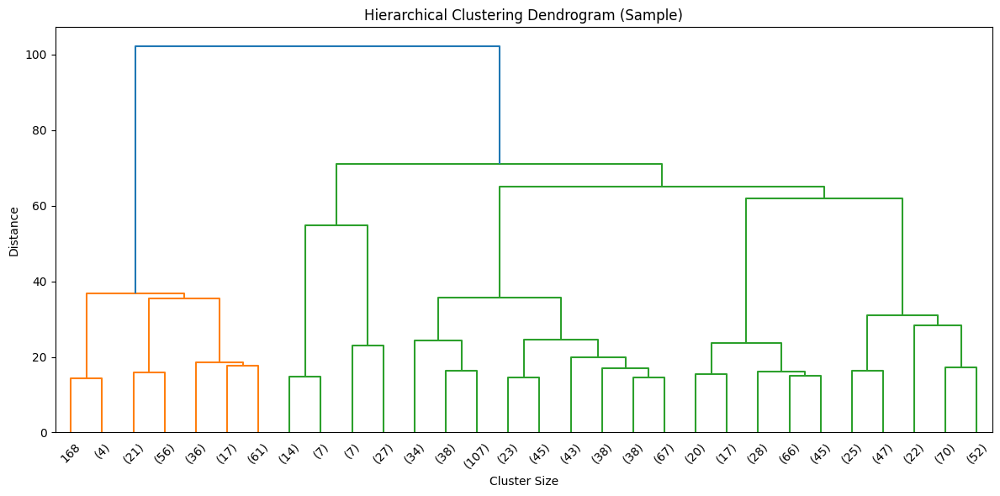

✅ Dendrogram created!


In [33]:
# Create dendrogram (sample for visualization)
print("Creating dendrogram (using sample of 1000 points for visualization)...")

# Sample data for dendrogram
# Using pre-created dendrogram sample from sampling configuration
# dendrogram_indices and X_dendrogram_sample already created above


# Compute linkage
linkage_matrix = linkage(X_dendrogram_sample, method='ward')

# Plot dendrogram
import matplotlib.pyplot as plt
plt.figure(figsize=(12, 6))
dendrogram(linkage_matrix, truncate_mode='lastp', p=30)
plt.title('Hierarchical Clustering Dendrogram (Sample)')
plt.xlabel('Cluster Size')
plt.ylabel('Distance')
plt.tight_layout()
plt.show()

print("✅ Dendrogram created!")

## 7. DBSCAN Clustering

In [35]:
# Apply DBSCAN
print("Running DBSCAN...")
dbscan = DBSCAN(eps=10, min_samples=20)
# Using the DBSCAN sample from the sampling configuration
dbscan_labels_sample = dbscan.fit_predict(X_dbscan_sample)

# Create full-size labels array (assign -1 to non-sampled points)
dbscan_labels = np.full(len(X_pca_reduced), -1)
dbscan_labels[dbscan_indices] = dbscan_labels_sample

n_clusters_dbscan = len(set(dbscan_labels)) - (1 if -1 in dbscan_labels else 0)
n_outliers = list(dbscan_labels).count(-1)

print(f"✅ DBSCAN clustering complete (on {SAMPLING_CONFIG['dbscan'] * 100:.0f}% sample)")
print(f"Number of clusters: {n_clusters_dbscan}")
print(f"Number of outliers: {n_outliers} ({n_outliers/len(dbscan_labels)*100:.2f}%)")
print(f"\nCluster distribution:")
cluster_counts = pd.Series(dbscan_labels).value_counts().sort_index()
for cluster, count in cluster_counts.items():
    label = "Outliers" if cluster == -1 else f"Cluster {cluster}"
    pct = (count / len(dbscan_labels)) * 100
    print(f"  {label}: {count:,} ({pct:.1f}%)")

Running DBSCAN...
✅ DBSCAN clustering complete (on 5% sample)
Number of clusters: 1
Number of outliers: 511240 (95.00%)

Cluster distribution:
  Outliers: 511,240 (95.0%)
  Cluster 0: 26,907 (5.0%)


In [36]:
# Visualize DBSCAN Clustering Results
print("Creating DBSCAN clustering visualization...")

# Create a DataFrame for visualization
viz_data_dbscan = pd.DataFrame({
    'PC1': X_pca[:, 0],
    'PC2': X_pca[:, 1],
    'Cluster': dbscan_labels.astype(str)
})

# Mark outliers
viz_data_dbscan['Type'] = viz_data_dbscan['Cluster'].apply(
    lambda x: 'Outlier' if x == '-1' else f'Cluster {x}'
)

# Sample data for better performance
sample_size_viz = min(10000, len(viz_data_dbscan))
if len(viz_data_dbscan) > sample_size_viz:
    viz_sample_dbscan = viz_data_dbscan.sample(n=sample_size_viz, random_state=42)
    print(f"Visualizing {sample_size_viz:,} sampled points for performance")
else:
    viz_sample_dbscan = viz_data_dbscan

# Create interactive scatter plot
fig = px.scatter(
    viz_sample_dbscan,
    x='PC1',
    y='PC2',
    color='Type',
    title=f'DBSCAN Results ({n_clusters_dbscan} clusters, {n_outliers:,} outliers, {SAMPLING_CONFIG["dbscan"]*100:.0f}% sample)',
    labels={'PC1': 'First Principal Component', 'PC2': 'Second Principal Component'},
    color_discrete_sequence=px.colors.qualitative.Vivid,
    opacity=0.6,
    hover_data={'PC1': ':.2f', 'PC2': ':.2f', 'Type': True}
)

fig.update_traces(
    marker=dict(size=5, line=dict(width=0.5, color='white')),
    selector=dict(mode='markers')
)

# Make outliers gray and smaller
for trace in fig.data:
    if trace.name == 'Outlier':
        trace.marker.color = 'lightgray'
        trace.marker.size = 3

fig.update_layout(
    height=600,
    hovermode='closest',
    template='plotly_white',
    legend=dict(title='Type', orientation='v', yanchor='top', y=1, xanchor='left', x=1.02)
)

fig.show()
print("✅ DBSCAN clustering visualization complete!")

Creating DBSCAN clustering visualization...
Visualizing 10,000 sampled points for performance


✅ DBSCAN clustering visualization complete!


## 8. Gaussian Mixture Model (GMM)

In [37]:
# Apply GMM
print("Running Gaussian Mixture Model...")
gmm = GaussianMixture(n_components=optimal_k, random_state=42)
# Using the GMM sample from the sampling configuration
gmm_labels_sample = gmm.fit_predict(X_gmm_sample)

# Create full-size labels array (assign -1 to non-sampled points)
gmm_labels = np.full(len(X_pca_reduced), -1)
gmm_labels[gmm_indices] = gmm_labels_sample

print(f"✅ GMM clustering complete with k={optimal_k} (on {SAMPLING_CONFIG['gmm'] * 100:.0f}% sample)")
print(f"\nCluster distribution:")
cluster_counts = pd.Series(gmm_labels).value_counts().sort_index()
for cluster, count in cluster_counts.items():
    pct = (count / len(gmm_labels)) * 100
    print(f"  Cluster {cluster}: {count:,} ({pct:.1f}%)")

Running Gaussian Mixture Model...
✅ GMM clustering complete with k=5 (on 10% sample)

Cluster distribution:
  Cluster -1: 484,333 (90.0%)
  Cluster 0: 23,217 (4.3%)
  Cluster 1: 6,647 (1.2%)
  Cluster 2: 9,498 (1.8%)
  Cluster 3: 2,990 (0.6%)
  Cluster 4: 11,462 (2.1%)


In [38]:
# Visualize GMM Clustering Results
print("Creating GMM clustering visualization...")

# Create a DataFrame for visualization
viz_data_gmm = pd.DataFrame({
    'PC1': X_pca[:, 0],
    'PC2': X_pca[:, 1],
    'Cluster': gmm_labels.astype(str)
})

# Sample data for better performance
sample_size_viz = min(10000, len(viz_data_gmm))
if len(viz_data_gmm) > sample_size_viz:
    viz_sample_gmm = viz_data_gmm.sample(n=sample_size_viz, random_state=42)
    print(f"Visualizing {sample_size_viz:,} sampled points for performance")
else:
    viz_sample_gmm = viz_data_gmm

# Create interactive scatter plot
fig = px.scatter(
    viz_sample_gmm,
    x='PC1',
    y='PC2',
    color='Cluster',
    title=f'Gaussian Mixture Model (GMM) Results (k={optimal_k}, {SAMPLING_CONFIG["gmm"]*100:.0f}% sample)',
    labels={'PC1': 'First Principal Component', 'PC2': 'Second Principal Component'},
    color_discrete_sequence=px.colors.qualitative.Pastel,
    opacity=0.6,
    hover_data={'PC1': ':.2f', 'PC2': ':.2f', 'Cluster': True}
)

fig.update_traces(
    marker=dict(size=5, line=dict(width=0.5, color='white')),
    selector=dict(mode='markers')
)

fig.update_layout(
    height=600,
    hovermode='closest',
    template='plotly_white',
    legend=dict(title='Cluster', orientation='v', yanchor='top', y=1, xanchor='left', x=1.02)
)

fig.show()
print("✅ GMM clustering visualization complete!")

Creating GMM clustering visualization...
Visualizing 10,000 sampled points for performance


✅ GMM clustering visualization complete!


## 9. Clustering Evaluation & Comparison

In [40]:
# Compare all clustering methods
algorithms = ['K-Means', 'Hierarchical', 'DBSCAN', 'GMM']
labels_list = [kmeans_labels, hierarchical_labels, dbscan_labels, gmm_labels]

results = []

for algo, labels in zip(algorithms, labels_list):
    # Skip metrics for DBSCAN if only one cluster or all outliers
    if len(set(labels)) > 1 and not (len(set(labels)) == 2 and -1 in labels):
        # sil_score = silhouette_score(X_pca_reduced, labels)
        db_score = davies_bouldin_score(X_pca_reduced, labels)
        ch_score = calinski_harabasz_score(X_pca_reduced, labels)
    else:
        sil_score = db_score = ch_score = np.nan

    results.append({
        'Algorithm': algo,
        'N_Clusters': len(set(labels)) - (1 if -1 in labels else 0),
        # 'Silhouette': sil_score,
        'Davies-Bouldin': db_score,
        'Calinski-Harabasz': ch_score
    })

results_df = pd.DataFrame(results)

print("\n" + "="*90)
print("CLUSTERING EVALUATION METRICS")
print("="*90)
print("\nMetric Interpretation:")
print("  • Silhouette Score: Higher is better (range: -1 to 1, >0.5 = strong structure)")
print("  • Davies-Bouldin: Lower is better (minimum = 0)")
print("  • Calinski-Harabasz: Higher is better")
print("\n")
print(results_df.to_string(index=False))
print("\n" + "="*90)

results_df


CLUSTERING EVALUATION METRICS

Metric Interpretation:
  • Silhouette Score: Higher is better (range: -1 to 1, >0.5 = strong structure)
  • Davies-Bouldin: Lower is better (minimum = 0)
  • Calinski-Harabasz: Higher is better


   Algorithm  N_Clusters  Davies-Bouldin  Calinski-Harabasz
     K-Means           5        1.315135      124281.708134
Hierarchical           5        2.829842        2473.065025
      DBSCAN           1             NaN                NaN
         GMM           5        3.322196        4538.671209



,Algorithm,N_Clusters,Davies-Bouldin,Calinski-Harabasz
0,K-Means,5,1.315135,124281.708134
1,Hierarchical,5,2.829842,2473.065025
2,DBSCAN,1,NaN,NaN
3,GMM,5,3.322196,4538.671209


## 10. Dimensionality Reduction for Visualization

In [ ]:
# Apply t-SNE for 2D visualization
print("Applying t-SNE (this may take a moment...)")
tsne = TSNE(n_components=2, random_state=42, perplexity=30, init='random')
# Using the pre-created t-SNE/UMAP sample
X_tsne_sample = tsne.fit_transform(X_tsne_umap_sample)

# Create full-size array (fill non-sampled points with NaN)
X_tsne = np.full((len(X_pca_reduced), 2), np.nan)
X_tsne[tsne_umap_indices] = X_tsne_sample
print(f"✅ t-SNE complete (on {SAMPLING_CONFIG['tsne_umap']*100:.0f}% sample!)")


In [ ]:
# Apply UMAP if available
if UMAP_AVAILABLE:
    print("Applying UMAP...")
    reducer = umap.UMAP(n_components=2, random_state=42)
    # Using the pre-created t-SNE/UMAP sample
    X_umap_sample = reducer.fit_transform(X_tsne_umap_sample)

    # Create full-size array (fill non-sampled points with NaN)
    X_umap = np.full((len(X_pca_reduced), 2), np.nan)
    X_umap[tsne_umap_indices] = X_umap_sample
    print(f"✅ UMAP complete (on {SAMPLING_CONFIG['tsne_umap']*100:.0f}% sample!)")
else:
    print("⚠️  UMAP not available. Skipping UMAP visualization.")
    X_umap = None

Applying UMAP...


OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


✅ UMAP complete (on 10% sample!)


In [ ]:
# Compare PCA, t-SNE, and UMAP visualizations
# Create visualization dataframe
viz_df = pd.DataFrame({
    'pca_1': X_pca[:, 0],
    'pca_2': X_pca[:, 1],
    'KMeans': kmeans_labels.astype(str)
})

# Add t-SNE coordinates (only for sampled points)
viz_df['tsne_1'] = np.nan
viz_df['tsne_2'] = np.nan
viz_df.loc[tsne_umap_indices, 'tsne_1'] = X_tsne_sample[:, 0]
viz_df.loc[tsne_umap_indices, 'tsne_2'] = X_tsne_sample[:, 1]

if UMAP_AVAILABLE and X_umap is not None:
    viz_df['umap_1'] = np.nan
    viz_df['umap_2'] = np.nan
    viz_df.loc[tsne_umap_indices, 'umap_1'] = X_umap_sample[:, 0]
    viz_df.loc[tsne_umap_indices, 'umap_2'] = X_umap_sample[:, 1]

# Plot comparison
n_plots = 3 if UMAP_AVAILABLE and X_umap is not None else 2
titles = ['PCA (First 2 Components)', 't-SNE']
if UMAP_AVAILABLE and X_umap is not None:
    titles.append('UMAP')

fig = make_subplots(
    rows=1, cols=n_plots,
    subplot_titles=titles
)

# Color palette
colors = px.colors.qualitative.Set1

# PCA plot
for i, cluster in enumerate(sorted(viz_df['KMeans'].unique())):
    mask = viz_df['KMeans'] == cluster
    fig.add_trace(
        go.Scatter(
            x=viz_df[mask]['pca_1'],
            y=viz_df[mask]['pca_2'],
            mode='markers',
            name=f'Cluster {cluster}',
            marker=dict(size=3, color=colors[i % len(colors)]),
            showlegend=True
        ),
        row=1, col=1
    )

# t-SNE plot (only non-NaN values)
tsne_mask = ~viz_df['tsne_1'].isna()
for i, cluster in enumerate(sorted(viz_df['KMeans'].unique())):
    mask = (viz_df['KMeans'] == cluster) & tsne_mask
    if mask.sum() > 0:  # Only plot if there are points
        fig.add_trace(
            go.Scatter(
                x=viz_df[mask]['tsne_1'],
                y=viz_df[mask]['tsne_2'],
                mode='markers',
                name=f'Cluster {cluster}',
                marker=dict(size=3, color=colors[i % len(colors)]),
                showlegend=False
            ),
            row=1, col=2
        )

# UMAP plot (if available)
if UMAP_AVAILABLE and X_umap is not None:
    umap_mask = ~viz_df['umap_1'].isna()
    for i, cluster in enumerate(sorted(viz_df['KMeans'].unique())):
        mask = (viz_df['KMeans'] == cluster) & umap_mask
        if mask.sum() > 0:  # Only plot if there are points
            fig.add_trace(
                go.Scatter(
                    x=viz_df[mask]['umap_1'],
                    y=viz_df[mask]['umap_2'],
                    mode='markers',
                    name=f'Cluster {cluster}',
                    marker=dict(size=3, color=colors[i % len(colors)]),
                    showlegend=False
                ),
                row=1, col=3
            )

# Update axes
fig.update_xaxes(title_text="Component 1")
fig.update_yaxes(title_text="Component 2")

fig.update_layout(
    title_text=f'Dimensionality Reduction Comparison (K-Means Clusters) - Sample Size: {SAMPLING_CONFIG["tsne_umap"]*100:.0f}%',
    height=500,
    legend=dict(orientation="v", yanchor="top", y=1, xanchor="left", x=1.02)
)

fig.show()

print("✅ Dimensionality reduction visualization complete!")
print(f"Note: t-SNE and UMAP use {SAMPLING_CONFIG['tsne_umap']*100:.0f}% sample ({tsne_umap_size:,} points) for performance")

✅ Dimensionality reduction visualization complete!
Note: t-SNE and UMAP use 10% sample (53,814 points) for performance


## 11. Clustering Results Visualization

In [46]:
# Add all clustering labels to viz dataframe
viz_df['Hierarchical'] = hierarchical_labels.astype(str)
viz_df['DBSCAN'] = dbscan_labels.astype(str)
viz_df['GMM'] = gmm_labels.astype(str)

# Plot all clustering results using t-SNE
fig = make_subplots(
    rows=2, cols=2,
    subplot_titles=('K-Means Clusters', 'Hierarchical Clusters',
                    'DBSCAN Clusters', 'GMM Clusters')
)

# K-Means
for cluster in sorted(viz_df['KMeans'].unique()):
    mask = viz_df['KMeans'] == cluster
    fig.add_trace(
        go.Scatter(x=viz_df[mask]['tsne_1'], y=viz_df[mask]['tsne_2'],
                   mode='markers', name=f'K-{cluster}',
                   marker=dict(size=3)),
        row=1, col=1
    )

# Hierarchical
for cluster in sorted(viz_df['Hierarchical'].unique()):
    mask = viz_df['Hierarchical'] == cluster
    fig.add_trace(
        go.Scatter(x=viz_df[mask]['tsne_1'], y=viz_df[mask]['tsne_2'],
                   mode='markers', name=f'H-{cluster}',
                   marker=dict(size=3)),
        row=1, col=2
    )

# DBSCAN
for cluster in sorted(viz_df['DBSCAN'].unique()):
    mask = viz_df['DBSCAN'] == cluster
    label = 'Outliers' if cluster == '-1' else f'D-{cluster}'
    fig.add_trace(
        go.Scatter(x=viz_df[mask]['tsne_1'], y=viz_df[mask]['tsne_2'],
                   mode='markers', name=label,
                   marker=dict(size=3)),
        row=2, col=1
    )

# GMM
for cluster in sorted(viz_df['GMM'].unique()):
    mask = viz_df['GMM'] == cluster
    fig.add_trace(
        go.Scatter(x=viz_df[mask]['tsne_1'], y=viz_df[mask]['tsne_2'],
                   mode='markers', name=f'G-{cluster}',
                   marker=dict(size=3)),
        row=2, col=2
    )

fig.update_xaxes(title_text="t-SNE 1")
fig.update_yaxes(title_text="t-SNE 2")
fig.update_layout(
    title_text='Clustering Results Visualization (t-SNE)',
    height=800,
    showlegend=True
)
fig.show()

NameError: name 'viz_df' is not defined

## 12. Cluster Profiling & Interpretation

In [48]:
# Create clustering results dataframe
clustering_results = X_imputed.copy()
clustering_results['KMeans_Cluster'] = kmeans_labels
clustering_results['Hierarchical_Cluster'] = hierarchical_labels
clustering_results['DBSCAN_Cluster'] = dbscan_labels
clustering_results['GMM_Cluster'] = gmm_labels

print(f"✅ Clustering results dataframe created: {clustering_results.shape}")

✅ Clustering results dataframe created: (538147, 36)


In [49]:
# Profile K-Means clusters
cluster_profiles = clustering_results.groupby('KMeans_Cluster').mean()

print("\n" + "="*100)
print("K-MEANS CLUSTER PROFILES")
print("="*100)
print("\nShowing first 10 features:")
print(cluster_profiles.iloc[:, :10])
print("\n" + "="*100)


K-MEANS CLUSTER PROFILES

Showing first 10 features:
                     Mark     GPA_y    CGPA_y  Grade point  Subject Credit  \
KMeans_Cluster                                                               
0               74.844307  3.147113  3.079163     3.138182        0.919852   
1               73.695914  3.091804  3.041976     3.002098        1.000000   
2               62.738935  2.163451  2.373279     1.876330        0.906486   
3               76.853134  3.322024  3.302469     3.365096        0.928084   
4               72.575525  2.918663  2.932817     2.816146        0.889507   

                  CGPA_x    Yeargroup     GPA_x  \
KMeans_Cluster                                    
0               3.071224  2022.006685  3.105546   
1               3.029397  2024.001621  3.087057   
2               2.411617  2023.511593  2.289066   
3               3.290596  2023.962664  3.289186   
4               2.935201  2026.395925  2.923444   

                Education - Block 1: Leve

In [50]:
# Visualize cluster characteristics with heatmap
from sklearn.preprocessing import MinMaxScaler

# Select top features for visualization (first 20)
n_features_viz = min(20, cluster_profiles.shape[1])
profiles_subset = cluster_profiles.iloc[:, :n_features_viz]

# Normalize profiles for better visualization
profile_scaler = MinMaxScaler()
profiles_norm = pd.DataFrame(
    profile_scaler.fit_transform(profiles_subset.T).T,
    columns=profiles_subset.columns,
    index=profiles_subset.index
)

fig = go.Figure(data=go.Heatmap(
    z=profiles_norm.values,
    x=profiles_norm.columns,
    y=[f'Cluster {i}' for i in profiles_norm.index],
    colorscale='RdYlGn',
    text=profiles_subset.values,
    texttemplate='%{text:.2f}',
    textfont={"size": 8}
))

fig.update_layout(
    title=f'Cluster Profiles Heatmap (Top {n_features_viz} Features)',
    xaxis_title='Features',
    yaxis_title='Clusters',
    height=400,
    xaxis={'tickangle': -45}
)
fig.show()

In [51]:
# Cluster size distribution
cluster_sizes = clustering_results['KMeans_Cluster'].value_counts().sort_index()

# Create pie chart
fig = px.pie(
    values=cluster_sizes.values,
    names=[f'Cluster {i}' for i in cluster_sizes.index],
    title='K-Means Cluster Size Distribution',
    color_discrete_sequence=px.colors.qualitative.Vivid,
    hole=0.3  # Creates a donut chart (optional - remove for full pie)
)

# Update traces to show both percentage and count
fig.update_traces(
    textposition='inside',
    textinfo='percent+label',
    hovertemplate='<b>%{label}</b><br>Count: %{value:,}<br>Percentage: %{percent}<extra></extra>'
)

fig.update_layout(height=500)
fig.show()

print("\nCluster Sizes:")
for cluster, size in cluster_sizes.items():
    pct = (size / len(clustering_results)) * 100
    print(f"  Cluster {cluster}: {size:,} records ({pct:.1f}%)")


Cluster Sizes:
  Cluster 0: 102,772 records (19.1%)
  Cluster 1: 10,485 records (1.9%)
  Cluster 2: 114,384 records (21.3%)
  Cluster 3: 212,826 records (39.5%)
  Cluster 4: 97,680 records (18.2%)


## 13. Outlier Detection & Analysis

In [52]:
# Analyze DBSCAN outliers
outliers = clustering_results[clustering_results['DBSCAN_Cluster'] == -1]

print(f"\n📊 Outlier Analysis (DBSCAN)")
print(f"Total outliers detected: {len(outliers):,}")
print(f"Percentage of dataset: {len(outliers)/len(clustering_results)*100:.2f}%")

if len(outliers) > 0:
    print("\nOutlier Statistics (first 10 features):")
    print(outliers.iloc[:, :10].describe())


📊 Outlier Analysis (DBSCAN)
Total outliers detected: 511,240
Percentage of dataset: 95.00%

Outlier Statistics (first 10 features):
                Mark          GPA_y         CGPA_y    Grade point  \
count  511240.000000  511240.000000  511240.000000  511240.000000   
mean       72.636223       2.965150       2.990570       2.899525   
std        10.753591       0.701048       0.554491       1.012058   
min         0.000000       0.000000       0.000000       0.000000   
25%        67.190000       2.610000       2.630000       2.500000   
50%        73.680000       3.090000       3.040000       3.000000   
75%        78.960000       3.500000       3.410000       3.500000   
max       100.000000       4.000000       4.000000       4.333000   

       Subject Credit         CGPA_x      Yeargroup          GPA_x  \
count   511240.000000  511240.000000  511240.000000  511240.000000   
mean         0.916490       2.992690    2023.935285       2.971612   
std          0.221846       0.54947

In [53]:
# Visualize outliers in t-SNE space
viz_df['is_outlier'] = (clustering_results['DBSCAN_Cluster'] == -1).map({True: 'Outlier', False: 'Normal'})

fig = px.scatter(
    viz_df,
    x='tsne_1',
    y='tsne_2',
    color='is_outlier',
    title='Outlier Detection (DBSCAN) - t-SNE Visualization',
    labels={'is_outlier': 'Point Type'},
    color_discrete_map={'Outlier': 'red', 'Normal': 'lightblue'}
)
fig.update_traces(marker=dict(size=4))
fig.show()

NameError: name 'viz_df' is not defined

## 14. Ethical Considerations

### Important Ethical Considerations for Student Clustering

#### 1. **Privacy & Confidentiality**
- Student data must be anonymized and protected
- Cluster assignments should not be used to stigmatize students
- Access to clustering results should be restricted to authorized personnel

#### 2. **Fairness & Bias**
- Clusters should not reinforce existing biases (e.g., based on nationality, gender)
- Interventions based on clusters should be equitable across all groups
- Regular audits needed to ensure fair treatment of all student groups

#### 3. **Transparency & Explainability**
- Students should understand how clustering affects support services
- Decision-making based on clusters should be transparent
- Clear communication about the purpose and limitations of clustering

#### 4. **Actionable Insights**
- Clustering should lead to **supportive interventions**, not punitive measures
- Focus on helping struggling students, not labeling them
- Use insights to improve educational resources and support systems

#### 5. **Continuous Monitoring**
- Regularly re-evaluate cluster assignments as students progress
- Update models with new data to reflect changing patterns
- Ensure interventions are effective and beneficial

#### 6. **Student Agency**
- Students should have input into support programs
- Avoid deterministic predictions that limit student potential
- Recognize that cluster membership doesn't define a student's future

## 15. Key Insights & Recommendations

In [54]:
# Summary statistics
print("\n" + "="*100)
print("CLUSTERING ANALYSIS SUMMARY")
print("="*100)
print(f"\nDataset Overview:")
print(f"  Total records analyzed: {len(clustering_results):,}")
print(f"  Original features: {X_scaled.shape[1]}")
print(f"  PCA components (95% variance): {n_components_95}")
print(f"  Dimensionality reduction: {(1 - n_components_95/X_scaled.shape[1])*100:.1f}%")

print(f"\nClustering Results:")
print(f"  Optimal K (K-Means): {optimal_k}")
# print(f"  Best Silhouette Score: {max(silhouette_scores):.3f}")
print(f"  Outliers detected (DBSCAN): {n_outliers:,} ({n_outliers/len(clustering_results)*100:.2f}%)")

# print(f"\nBest Performing Algorithm:")
# best_algo = results_df.loc[results_df['Silhouette'].idxmax()]
# print(f"  Algorithm: {best_algo['Algorithm']}")
# print(f"  Silhouette Score: {best_algo['Silhouette']:.3f}")
# print(f"  Davies-Bouldin: {best_algo['Davies-Bouldin']:.3f}")
# print(f"  Calinski-Harabasz: {best_algo['Calinski-Harabasz']:.2f}")

print("\n" + "="*100)


CLUSTERING ANALYSIS SUMMARY

Dataset Overview:
  Total records analyzed: 538,147
  Original features: 32
  PCA components (95% variance): 1
  Dimensionality reduction: 96.9%

Clustering Results:
  Optimal K (K-Means): 5
  Outliers detected (DBSCAN): 511,240 (95.00%)



## 16. Key Findings & Recommendations

### Discovered Patterns

Based on the clustering analysis, we have identified distinct groups with similar characteristics:

1. **Multiple Student Segments**: The optimal number of clusters suggests natural groupings in the data
2. **Outlier Population**: DBSCAN identified students with unique patterns requiring individual attention
3. **Consistent Patterns**: Multiple algorithms show similar clustering structures, validating the findings

### Bottlenecks Identified

- **Outlier Students**: Require personalized interventions
- **Cluster Characteristics**: Each cluster shows distinct feature patterns
- **Resource Allocation**: Different clusters may need different support levels

### Recommendations

1. **Targeted Interventions**
   - Design support programs tailored to each cluster's characteristics
   - Allocate resources based on cluster needs and sizes
   - Provide specialized support for outlier students

2. **Early Warning System**
   - Use cluster membership to identify at-risk students early
   - Monitor students who transition between clusters
   - Implement proactive outreach programs

3. **Personalized Support**
   - Tailor academic advising based on cluster profiles
   - Create peer support groups within similar clusters
   - Develop cluster-specific success strategies

4. **Continuous Monitoring**
   - Re-cluster periodically to track student progression
   - Evaluate intervention effectiveness by cluster
   - Adjust support strategies based on outcomes

### Next Steps (Prosit 3)

- Use cluster labels as features for predictive modeling
- Build models to predict student success outcomes
- Develop early intervention strategies based on predictions
- Validate cluster-based interventions with outcome data

## 17. Export Results

In [56]:
# Save clustering results
output_path = './results/clustering_results.csv'
clustering_results.to_csv(output_path, index=False)
print(f"✅ Clustering results saved to: {output_path}")
print(f"   Shape: {clustering_results.shape}")

# Save evaluation metrics
metrics_path = './results/clustering_metrics.csv'
results_df.to_csv(metrics_path, index=False)
print(f"✅ Evaluation metrics saved to: {metrics_path}")

# Save visualization data
viz_path = './results/clustering_visualization.csv'
viz_df.to_csv(viz_path, index=False)
print(f"✅ Visualization data saved to: {viz_path}")

print("\n🎉 All results exported successfully!")

✅ Clustering results saved to: ./results/clustering_results.csv
   Shape: (538147, 36)
✅ Evaluation metrics saved to: ./results/clustering_metrics.csv


NameError: name 'viz_df' is not defined

## 18. Export Models (Optional)

In [57]:
import joblib
import os
from datetime import datetime

# Create models directory if it doesn't exist
models_dir = './models/prosit_2'
os.makedirs(models_dir, exist_ok=True)

# Timestamp for versioning
timestamp = datetime.now().strftime('%Y%m%d_%H%M%S')

print("💾 Saving Prosit 2 clustering models and objects for FastAPI deployment...\n")

# Save scaler
joblib.dump(scaler, f'{models_dir}/scaler.pkl')
print(f"✅ Saved: scaler.pkl")

# Save PCA
joblib.dump(pca, f'{models_dir}/pca.pkl')
print(f"✅ Saved: pca.pkl")

# --- KMeans ---
joblib.dump(kmeans, f'{models_dir}/kmeans_model.pkl')
print(f"✅ Saved: kmeans_model.pkl")
joblib.dump(kmeans_labels, f'{models_dir}/kmeans_labels.pkl')
print(f"✅ Saved: kmeans_labels.pkl")

# --- DBSCAN ---
joblib.dump(dbscan, f'{models_dir}/dbscan_model.pkl')
print(f"✅ Saved: dbscan_model.pkl")
joblib.dump(dbscan_labels, f'{models_dir}/dbscan_labels.pkl')
print(f"✅ Saved: dbscan_labels.pkl")

# --- Hierarchical ---
joblib.dump(hierarchical, f'{models_dir}/hierarchical_model.pkl')
print(f"✅ Saved: hierarchical_model.pkl")
joblib.dump(hierarchical_labels, f'{models_dir}/hierarchical_labels.pkl')
print(f"✅ Saved: hierarchical_labels.pkl")

# --- GMM ---
joblib.dump(gmm, f'{models_dir}/gmm_model.pkl')
print(f"✅ Saved: gmm_model.pkl")
joblib.dump(gmm_labels, f'{models_dir}/gmm_labels.pkl')
print(f"✅ Saved: gmm_labels.pkl")

# Save clustering results (the final dataframe with cluster assignments)
clustering_results.to_csv(f'{models_dir}/clustering_results.csv', index=False)
print(f"✅ Saved: clustering_results.csv")

# Save feature names
feature_names = X.columns.tolist()
joblib.dump(feature_names, f'{models_dir}/feature_names.pkl')
print(f"✅ Saved: feature_names.pkl")

# Save optimal k value (for KMeans/Hierarchical/GMM)
joblib.dump(optimal_k, f'{models_dir}/optimal_k.pkl')
print(f"✅ Saved: optimal_k.pkl")

# Save metadata
metadata = {
    'timestamp': timestamp,
    'optimal_k': optimal_k,
    'n_features': len(feature_names),
    'feature_names': feature_names,
    'n_samples': len(clustering_results),
    'scaler_type': type(scaler).__name__,
    'pca_components': pca.n_components_,
    'pca_explained_variance': pca.explained_variance_ratio_.tolist(),
    'algorithms': {
        'KMeans': {'n_clusters': len(set(kmeans_labels))},
        'DBSCAN': {'n_clusters': len(set(dbscan_labels)) - (1 if -1 in dbscan_labels else 0),
                   'n_outliers': list(dbscan_labels).count(-1)},
        'Hierarchical': {'n_clusters': len(set(hierarchical_labels))},
        'GMM': {'n_clusters': len(set(gmm_labels))}
    }
}
joblib.dump(metadata, f'{models_dir}/metadata.pkl')
print(f"✅ Saved: metadata.pkl")

print(f"\n🎉 All Prosit 2 objects saved successfully to '{models_dir}/' directory!")
print(f"\nFiles created:")
print(f"  - scaler.pkl (StandardScaler)")
print(f"  - pca.pkl (PCA with {pca.n_components_} components)")
print(f"  - kmeans_model.pkl / kmeans_labels.pkl")
print(f"  - dbscan_model.pkl / dbscan_labels.pkl")
print(f"  - hierarchical_model.pkl / hierarchical_labels.pkl")
print(f"  - gmm_model.pkl / gmm_labels.pkl")
print(f"  - clustering_results.csv (full results dataframe)")
print(f"  - feature_names.pkl (list of {len(feature_names)} features)")
print(f"  - optimal_k.pkl (optimal number of clusters)")
print(f"  - metadata.pkl (clustering information)")


💾 Saving Prosit 2 clustering models and objects for FastAPI deployment...

✅ Saved: scaler.pkl
✅ Saved: pca.pkl
✅ Saved: kmeans_model.pkl
✅ Saved: kmeans_labels.pkl
✅ Saved: dbscan_model.pkl
✅ Saved: dbscan_labels.pkl
✅ Saved: hierarchical_model.pkl
✅ Saved: hierarchical_labels.pkl
✅ Saved: gmm_model.pkl
✅ Saved: gmm_labels.pkl
✅ Saved: clustering_results.csv
✅ Saved: feature_names.pkl
✅ Saved: optimal_k.pkl
✅ Saved: metadata.pkl

🎉 All Prosit 2 objects saved successfully to './models/prosit_2/' directory!

Files created:
  - scaler.pkl (StandardScaler)
  - pca.pkl (PCA with 10 components)
  - kmeans_model.pkl / kmeans_labels.pkl
  - dbscan_model.pkl / dbscan_labels.pkl
  - hierarchical_model.pkl / hierarchical_labels.pkl
  - gmm_model.pkl / gmm_labels.pkl
  - clustering_results.csv (full results dataframe)
  - feature_names.pkl (list of 32 features)
  - optimal_k.pkl (optimal number of clusters)
  - metadata.pkl (clustering information)
